<a href="https://colab.research.google.com/github/NaomiMwende/Deep_Learning_Bootcamp/blob/master/TUNISIA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

BUSINESS UNDERSTANDING

Tax fraud is the intentional act of lying on a tax return form with the intent to lower one’s tax liability. Under-reporting is one of the most common types of tax frauds. It consists of filing a tax return form with a lesser tax base. As a result of this act, fiscal revenues are reduced, undermining public investment in much-needed services.

The objective of the challenge is to detect tax fraud.
Using historical data, a supervised machine learning technique that detects potential fraudulent taxpayers will increase the operational efficiency of the tax supervision process.



DATA PREPARATION

In [1195]:
#Importing the necessary libraries

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

pd.set_option('display.max_columns',None)
pd.set_option('display.max_rows',None)

In [1196]:
#Importing our train data

df = pd.read_csv("/content/SUPCOM_Train.csv")

In [1197]:
#preview our dataset
df.head(5)

,BCT_CODBUR,CTR_MATFIS,CTR_CATEGO_X,FJU_CODFJU,CTR_CESSAT,ACT_CODACT,CTR_OBLDIR,CTR_OBLACP,CTR_OBLRES,CTR_OBLFOP,CTR_OBLTFP,CTR_OBLDCO,CTR_OBLTVA,CTR_OFODEC,CTR_OFODEP,CTR_OFODET,CTR_OBLAUT,CTR_OBLASS,CTR_ODTIMB,CTR_OBLTCL,CTR_OBLTHO,CTR_OBLDLI,CTR_OBLTVI,CTR_RATISS,EXE_EXERCI,TVA_CHAFF6,TVA_CHAFF7,TVA_CHAF10,TVA_CHAF12,TVA_CAF125,TVA_CHAF15,TVA_CHAF18,TVA_CHAF22,TVA_CHAF29,TVA_CHAF36,TVA_TOTDUE,TVA_MOIDEB,TVA_CRDINI,TVA_BASIMB,TVA_DEDIMB,TVA_BASEQL,TVA_DEDEQL,TVA_BASEQI,TVA_DEDEQI,TVA_BASAUL,TVA_DEDAUL,TVA_BASAUI,TVA_DEDAUI,TVA_BASRSM,TVA_DEDRSM,TVA_RSNRES,TVA_TRSPOR,TVA_DEDREG,TVA_RESTIT,TVA_MNTPAY,TVA_MOIFIN,TVA_CRDFIN,TVA_ACHSUS,TVA_ACHEXO,TVA_ACHNDD,TVA_CAFEXP,TVA_CAFSUS,TVA_CAFEXO,TVA_AACHAB,TVA_CRDBLQ,TVA_CRDRES,TVA_CRDRMP,TVA_CRDREP,TVA_CRDRMC,TVA_MACHN,TVA_MCESQ,TVA_MTVLSM,TVA_TXVLSM,TVA_MTALSM,TVA_TXALSM,TVA_MTORDTVA,TVA_MTDJRTVA,TVA_MTORDTAX,TVA_MTDJRTAX,TVA_MTRESTAX,TVA_CA072018,TVA_CA132018,TVA_CA192018,ADB_MNTORD,SND_MNTPRD_I,SND_MNTTVA_I,SND_MNTDRC_I,SND_MNTAVA_I,SND_MNTTAX_I,SND_MNTPAY_I,SND_MNTAIR_I,SND_MNTPRD_E,SND_MNTTVA_E,SND_MNTDRC_E,SND_MNTAVA_E,SND_MNTTAX_E,SND_MNTPAY_E,SND_MNTAIR_E,SND_MNTPRD_A,SND_MNTTVA_A,SND_MNTDRC_A,SND_MNTAVA_A,SND_MNTTAX_A,SND_MNTPAY_A,SND_MNTAIR_A,AX1_BRTIMP,AX2_HONORA,AX2_LOYERS,AX3_REVCAP,AX5_MNTMAR,RES_ANNIMP,target,FAC_MNTPRI_F,FAC_MFODEC_F,FAC_MNTDCO_F,FAC_MNTTVA_F,FAC_MNTPRI_C,FAC_MFODEC_C,FAC_MNTDCO_C,FAC_MNTTVA_C,id
0,44,6210,C,99,0,3707,4,2,2,2,2,1,2,1.0,1.0,1.0,1.0,1.0,2.0,3,1.0,1.0,1.0,0,2014,0.0,0.0,0.0,126423147.0,0.0,0.0,755492735.0,0.0,0.0,0.0,151159466.0,1.0,0.0,0.0,0.0,203502320.0,40671108.0,168448614.0,23214917.0,237652610.0,39987369.0,52750313.0,7884392.0,7969950.0,3984975.0,0.0,0.0,0.0,0.0,35416705.0,12.0,0.0,0.0,0.0,0.0,37590000.0,610000.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,831900.0,192717832.0,24374617.0,0.0,0.0,3947479.0,28322096.0,740196.0,30077000.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,2950000.0,0.0,0.0,602769328.0,2014,16.639203,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,train_id17437
1,401,14383,M,22,0,6105,4,2,2,2,2,1,2,1.0,1.0,1.0,1.0,1.0,2.0,3,1.0,1.0,1.0,0,2013,0.0,0.0,0.0,21916400.0,0.0,0.0,0.0,0.0,0.0,0.0,2629968.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2772366.0,499026.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2130942.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,203353885.0,0.0,0.0,14785200.0,2013,17.827703,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,train_id5086
2,243,11555,M,23,0,5751,4,2,2,2,2,1,2,2.0,1.0,1.0,1.0,1.0,2.0,3,1.0,1.0,1.0,0,2013,0.0,0.0,0.0,0.0,0.0,0.0,20373500.0,0.0,0.0,0.0,3667230.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,19552556.0,3411102.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,256128.0,12.0,0.0,0.0,0.0,0.0,0.0,23461000.0,7500000.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,10792800.0,2013,15.473503,25387000.0,0.0,0.0,4571280.0,NaN,NaN,NaN,NaN,train_id1443
3,72,6175,C,99,0,4402,4,2,2,2,2,1,2,1.0,1.0,2.0,2.0,1.0,1.0,3,1.0,2.0,1.0,0,2017,61381586.0,0.0,0.0,0.0,0.0,0.0,338481203.0,0.0,0.0,0.0,64609507.0,1.0,26974794.0,0.0,0.0,0.0,0.0,0.0,0.0,306229381.0,55121289.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,318095.0,12.0,17804671.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,2017,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,train_id15469
4,42,1417,M,23,0,6302,4,2,2,2,2,1,2,1.0,1.0,1.0,1.0,1.0,2.0,3,1.0,1.0,1.0,0,2014,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,Na

In [1198]:
df.columns

Index(['BCT_CODBUR', 'CTR_MATFIS', 'CTR_CATEGO_X', 'FJU_CODFJU', 'CTR_CESSAT',
       'ACT_CODACT', 'CTR_OBLDIR', 'CTR_OBLACP', 'CTR_OBLRES', 'CTR_OBLFOP',
       ...
       'target', 'FAC_MNTPRI_F', 'FAC_MFODEC_F', 'FAC_MNTDCO_F',
       'FAC_MNTTVA_F', 'FAC_MNTPRI_C', 'FAC_MFODEC_C', 'FAC_MNTDCO_C',
       'FAC_MNTTVA_C', 'id'],
      dtype='object', length=121)

In [1199]:
df.shape

(21295, 121)

In [1200]:
print(df.describe())
print(" ")
print("\n")
print(df.info())

         BCT_CODBUR    CTR_MATFIS    FJU_CODFJU    CTR_CESSAT    ACT_CODACT  \
count  21295.000000  21295.000000  21295.000000  21295.000000  21295.000000   
mean     214.935807   7797.448697     59.580888      0.048509   4821.595445   
std      162.992837   4484.430937     38.542427      0.228200   1168.628546   
min        9.000000      1.000000     10.000000      0.000000   1002.000000   
25%       92.000000   3944.000000     22.000000      0.000000   4203.000000   
50%      182.000000   7817.000000     23.000000      0.000000   4417.000000   
75%      254.000000  11695.500000     99.000000      0.000000   6102.000000   
max      700.000000  15603.000000     99.000000      2.000000   8999.000000   

         CTR_OBLDIR    CTR_OBLACP    CTR_OBLRES    CTR_OBLFOP    CTR_OBLTFP  \
count  21295.000000  21295.000000  21295.000000  21295.000000  21295.000000   
mean       4.454191      1.959850      1.977319      1.928105      1.949096   
std        1.205500      0.196316      0.154462    

DATA CLEANING

In [1201]:
df.duplicated().sum()

0

In [1202]:

df.isnull().sum()

BCT_CODBUR          0
CTR_MATFIS          0
CTR_CATEGO_X        0
FJU_CODFJU          0
CTR_CESSAT          0
ACT_CODACT          0
CTR_OBLDIR          0
CTR_OBLACP          0
CTR_OBLRES          0
CTR_OBLFOP          0
CTR_OBLTFP          0
CTR_OBLDCO          0
CTR_OBLTVA          0
CTR_OFODEC         10
CTR_OFODEP         10
CTR_OFODET         10
CTR_OBLAUT         10
CTR_OBLASS         10
CTR_ODTIMB         10
CTR_OBLTCL          0
CTR_OBLTHO         10
CTR_OBLDLI         10
CTR_OBLTVI         10
CTR_RATISS          0
EXE_EXERCI          0
TVA_CHAFF6       1690
TVA_CHAFF7       1690
TVA_CHAF10       1690
TVA_CHAF12       1690
TVA_CAF125       1690
TVA_CHAF15       1690
TVA_CHAF18       1690
TVA_CHAF22       1690
TVA_CHAF29       1690
TVA_CHAF36       1690
TVA_TOTDUE       1690
TVA_MOIDEB       1690
TVA_CRDINI       1690
TVA_BASIMB       1690
TVA_DEDIMB       1690
TVA_BASEQL       1690
TVA_DEDEQL       1690
TVA_BASEQI       1690
TVA_DEDEQI       1690
TVA_BASAUL       1690
TVA_DEDAUL

Our data does not have any duplicated values, however it has very many missing values. For missing values that are greater than 30% of our data we will drop them as they will lead to a huge bias in our analysis. We will then impute the other missing values with the median value.

In [1203]:
df["CTR_OFODEC"].fillna(df["CTR_OFODEC"].median(), inplace =True)
df["CTR_OFODEP"].fillna(df["CTR_OFODEP"].median(), inplace =True)
df["CTR_OFODET"].fillna(df["CTR_OFODET"].median(), inplace =True)
df["CTR_OBLAUT"].fillna(df["CTR_OBLAUT"].median(), inplace =True)
df["CTR_OBLASS"].fillna(df["CTR_OBLASS"].median(), inplace =True)
df["CTR_ODTIMB"].fillna(df["CTR_ODTIMB"].median(), inplace =True)
df["CTR_OBLTHO"].fillna(df["CTR_OBLTHO"].median(), inplace =True)
df["CTR_OBLDLI"].fillna(df["CTR_OBLDLI"].median(), inplace =True)
df["CTR_OBLTVI"].fillna(df["CTR_OBLTVI"].median(), inplace =True)
df["TVA_CHAFF6"].fillna(df["TVA_CHAFF6"].median(), inplace =True)
df["TVA_CHAFF7"].fillna(df["TVA_CHAFF7"].median(), inplace =True)
df["TVA_CHAF10"].fillna(df["TVA_CHAF10"].median(), inplace =True)
df["TVA_CHAF12"].fillna(df["TVA_CHAF12"].median(), inplace =True)
df["TVA_CAF125"].fillna(df["TVA_CAF125"].median(), inplace =True)
df["TVA_CHAF15"].fillna(df["TVA_CHAF15"].median(), inplace =True)
df["TVA_CHAF18"].fillna(df["TVA_CHAF18"].median(), inplace =True)
df["TVA_CHAF22"].fillna(df["TVA_CHAF22"].median(), inplace =True)
df["TVA_CHAF29"].fillna(df["TVA_CHAF29"].median(), inplace =True)
df["TVA_CHAF36"].fillna(df["TVA_CHAF36"].median(), inplace =True)
df["TVA_TOTDUE"].fillna(df["TVA_TOTDUE"].median(), inplace =True)
df["TVA_MOIDEB"].fillna(df["TVA_MOIDEB"].median(), inplace =True)
df["TVA_CRDINI"].fillna(df["TVA_CRDINI"].median(), inplace =True)
df['TVA_BASIMB'].fillna(df['TVA_BASIMB'].median(), inplace =True)
df['TVA_DEDIMB'].fillna(df['TVA_DEDIMB'].median(), inplace =True)
df['TVA_BASEQL'].fillna(df['TVA_BASEQL'].median(), inplace =True)
df['TVA_DEDEQL'].fillna(df['TVA_DEDEQL'].median(), inplace =True)
df['TVA_BASEQI'].fillna(df['TVA_BASEQI'].median(), inplace =True)
df['TVA_DEDEQI'].fillna(df['TVA_DEDEQI'].median(), inplace =True)
df['TVA_BASAUL'].fillna(df['TVA_BASAUL'].median(), inplace =True)
df['TVA_DEDAUL'].fillna(df['TVA_DEDAUL'].median(), inplace =True)
df['TVA_BASAUI'].fillna(df['TVA_BASAUI'].median(),inplace=True)
df["TVA_DEDAUI"].fillna(df["TVA_DEDAUI"].median(), inplace =True)
df['TVA_BASRSM'].fillna(df['TVA_BASRSM'].median(), inplace =True)
df['TVA_DEDRSM'].fillna(df['TVA_DEDRSM'].median(), inplace =True)
df['TVA_RSNRES'].fillna(df['TVA_RSNRES'].median(), inplace =True)
df['TVA_TRSPOR'].fillna(df['TVA_TRSPOR'].median(), inplace =True)
df['TVA_DEDREG'].fillna(df['TVA_DEDREG'].median(), inplace =True)
df['TVA_RESTIT'].fillna(df['TVA_RESTIT'].median(), inplace =True)
df['TVA_MNTPAY'].fillna(df['TVA_MNTPAY'].median(), inplace =True)
df['TVA_MOIFIN'].fillna(df['TVA_MOIFIN'].median(), inplace =True)
df['TVA_CRDFIN'].fillna(df['TVA_CRDFIN'].median(),inplace=True)
df['TVA_ACHSUS'].fillna(df['TVA_ACHSUS'].median(), inplace =True)
df['TVA_ACHEXO'].fillna(df['TVA_ACHEXO'].median(), inplace =True)
df['TVA_ACHNDD'].fillna(df['TVA_ACHNDD'].median(), inplace =True)
df['TVA_CAFEXP'].fillna(df['TVA_CAFEXP'].median(), inplace =True)
df['TVA_CAFSUS'].fillna(df['TVA_CAFSUS'].median(), inplace =True)
df['TVA_CAFEXO'].fillna(df['TVA_CAFEXO'].median(), inplace =True)
df['TVA_AACHAB'].fillna(df['TVA_AACHAB'].median(), inplace =True)
df['TVA_CRDBLQ'].fillna(df['TVA_CRDBLQ'].median(), inplace =True)
df['TVA_CRDRES'].fillna(df['TVA_CRDRES'].median(),inplace=True)
df['TVA_CRDRMP'].fillna(df['TVA_CRDRMP'].median(), inplace =True)
df['TVA_CRDREP'].fillna(df['TVA_CRDREP'].median(), inplace =True)
df['TVA_CRDRMC'].fillna(df['TVA_CRDRMC'].median(), inplace =True)
df['TVA_MACHN'].fillna(df['TVA_MACHN'].median(), inplace =True)
df['TVA_MCESQ'].fillna(df['TVA_MCESQ'].median(), inplace =True)
df['TVA_MTVLSM'].fillna(df['TVA_MTVLSM'].median(), inplace =True)
df['TVA_TXVLSM'].fillna(df['TVA_TXVLSM'].median(), inplace =True)
df['TVA_MTALSM'].fillna(df['TVA_MTALSM'].median(), inplace =True)
df['TVA_TXALSM'].fillna(df['TVA_TXALSM'].median(),inplace=True)
df['TVA_MTORDTVA'].fillna(df['TVA_MTORDTVA'].median(), inplace =True)
df['TVA_MTDJRTVA'].fillna(df['TVA_MTDJRTVA'].median(), inplace =True)
df['TVA_MTORDTAX'].fillna(df['TVA_MTORDTAX'].median(), inplace =True)
df['TVA_MTDJRTAX'].fillna(df['TVA_MTDJRTAX'].median(), inplace =True)
df['TVA_MTRESTAX'].fillna(df['TVA_MTRESTAX'].median(), inplace =True)
df['TVA_CA072018'].fillna(df['TVA_CA072018'].median(), inplace =True)
df['TVA_CA132018'].fillna(df['TVA_CA132018'].median(), inplace =True)
df['TVA_CRDBLQ'].fillna(df['TVA_CRDBLQ'].median(), inplace =True)
df['TVA_CA192018'].fillna(df['TVA_CA192018'].median(),inplace=True)

df['AX1_BRTIMP'].fillna(df['AX1_BRTIMP'].median(), inplace =True)
df['AX2_HONORA'].fillna(df['AX2_HONORA'].median(), inplace =True)
df['AX2_LOYERS'].fillna(df['AX2_LOYERS'].median(), inplace =True)
df['AX3_REVCAP'].fillna(df['AX3_REVCAP'].median(), inplace =True)
df['AX5_MNTMAR'].fillna(df['AX5_MNTMAR'].median(), inplace =True)





In [1204]:
df.isnull().sum()

BCT_CODBUR          0
CTR_MATFIS          0
CTR_CATEGO_X        0
FJU_CODFJU          0
CTR_CESSAT          0
ACT_CODACT          0
CTR_OBLDIR          0
CTR_OBLACP          0
CTR_OBLRES          0
CTR_OBLFOP          0
CTR_OBLTFP          0
CTR_OBLDCO          0
CTR_OBLTVA          0
CTR_OFODEC          0
CTR_OFODEP          0
CTR_OFODET          0
CTR_OBLAUT          0
CTR_OBLASS          0
CTR_ODTIMB          0
CTR_OBLTCL          0
CTR_OBLTHO          0
CTR_OBLDLI          0
CTR_OBLTVI          0
CTR_RATISS          0
EXE_EXERCI          0
TVA_CHAFF6          0
TVA_CHAFF7          0
TVA_CHAF10          0
TVA_CHAF12          0
TVA_CAF125          0
TVA_CHAF15          0
TVA_CHAF18          0
TVA_CHAF22          0
TVA_CHAF29          0
TVA_CHAF36          0
TVA_TOTDUE          0
TVA_MOIDEB          0
TVA_CRDINI          0
TVA_BASIMB          0
TVA_DEDIMB          0
TVA_BASEQL          0
TVA_DEDEQL          0
TVA_BASEQI          0
TVA_DEDEQI          0
TVA_BASAUL          0
TVA_DEDAUL

In [1205]:
df.dropna(inplace = True, axis = 1)

In [1206]:
df.isnull().sum()

BCT_CODBUR      0
CTR_MATFIS      0
CTR_CATEGO_X    0
FJU_CODFJU      0
CTR_CESSAT      0
ACT_CODACT      0
CTR_OBLDIR      0
CTR_OBLACP      0
CTR_OBLRES      0
CTR_OBLFOP      0
CTR_OBLTFP      0
CTR_OBLDCO      0
CTR_OBLTVA      0
CTR_OFODEC      0
CTR_OFODEP      0
CTR_OFODET      0
CTR_OBLAUT      0
CTR_OBLASS      0
CTR_ODTIMB      0
CTR_OBLTCL      0
CTR_OBLTHO      0
CTR_OBLDLI      0
CTR_OBLTVI      0
CTR_RATISS      0
EXE_EXERCI      0
TVA_CHAFF6      0
TVA_CHAFF7      0
TVA_CHAF10      0
TVA_CHAF12      0
TVA_CAF125      0
TVA_CHAF15      0
TVA_CHAF18      0
TVA_CHAF22      0
TVA_CHAF29      0
TVA_CHAF36      0
TVA_TOTDUE      0
TVA_MOIDEB      0
TVA_CRDINI      0
TVA_BASIMB      0
TVA_DEDIMB      0
TVA_BASEQL      0
TVA_DEDEQL      0
TVA_BASEQI      0
TVA_DEDEQI      0
TVA_BASAUL      0
TVA_DEDAUL      0
TVA_BASAUI      0
TVA_DEDAUI      0
TVA_BASRSM      0
TVA_DEDRSM      0
TVA_RSNRES      0
TVA_TRSPOR      0
TVA_DEDREG      0
TVA_RESTIT      0
TVA_MNTPAY      0
TVA_MOIFIN

BCT_CODBUR  CTR_MATFIS  CTR_CATEGO_X  FJU_CODFJU  CTR_CESSAT  ACT_CODACT  CTR_OBLDIR  CTR_OBLACP  CTR_OBLRES  CTR_OBLFOP  CTR_OBLTFP  CTR_OBLDCO  CTR_OBLTVA  CTR_OFODEC  CTR_OFODEP  CTR_OFODET  CTR_OBLAUT  CTR_OBLASS  CTR_ODTIMB  CTR_OBLTCL  CTR_OBLTHO  CTR_OBLDLI  CTR_OBLTVI  CTR_RATISS  EXE_EXERCI  TVA_CHAFF6    TVA_CHAFF7   TVA_CHAF10  TVA_CHAF12    TVA_CAF125  TVA_CHAF15    TVA_CHAF18    TVA_CHAF22    TVA_CHAF29  TVA_CHAF36  TVA_TOTDUE    TVA_MOIDEB  TVA_CRDINI    TVA_BASIMB    TVA_DEDIMB   TVA_BASEQL    TVA_DEDEQL    TVA_BASEQI    TVA_DEDEQI    TVA_BASAUL    TVA_DEDAUL    TVA_BASAUI    TVA_DEDAUI    TVA_BASRSM    TVA_DEDRSM    TVA_RSNRES    TVA_TRSPOR   TVA_DEDREG    TVA_RESTIT    TVA_MNTPAY    TVA_MOIFIN  TVA_CRDFIN    TVA_ACHSUS    TVA_ACHEXO    TVA_ACHNDD    TVA_CAFEXP    TVA_CAFSUS    TVA_CAFEXO    TVA_AACHAB   TVA_CRDBLQ    TVA_CRDRES    TVA_CRDRMP    TVA_CRDREP  TVA_CRDRMC    TVA_MACHN     TVA_MCESQ     TVA_MTVLSM    TVA_TXVLSM    TVA_MTALSM    TVA_TXALSM    TVA_MTORDTVA  TV

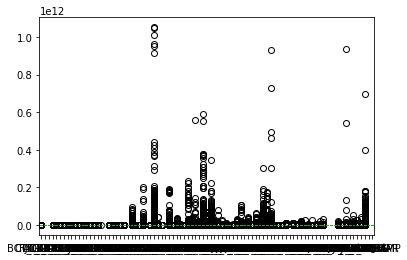

In [1207]:
df.plot(kind ="box")
df.value_counts()


Dropping outliers will lead to a lot of data loss, we will therefore work with an algorithm that is robust to outliers

DATA ANALYSIS

In [1208]:
"""column_name = df.columns
for column in column_name:
  print("\n")
  print("column_name:", columns)
  print(df[columns].value_counts())
  """

'column_name = df.columns\nfor column in column_name:\n  print("\n")\n  print("column_name:", columns)\n  print(df[columns].value_counts())\n  '

In [1209]:
#preview of our target variable unique values
df['target'].unique()

array([16.63920349, 17.82770294, 15.47350299, ..., 18.01877824,
       15.52110811, 12.46071874])

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


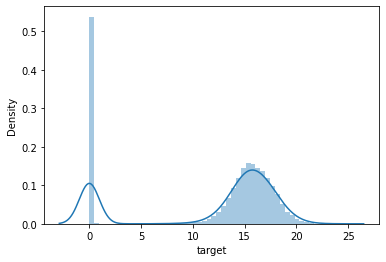

In [1210]:
sns.distplot(df['target'], bins= 50)

In [1211]:
df["target"].describe()

count    21295.000000
mean        11.780084
std          7.085772
min          0.000000
25%          0.000000
50%         14.981121
75%         16.625623
max         23.591334
Name: target, dtype: float64

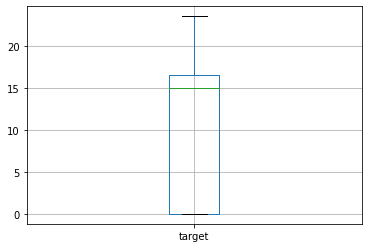

In [1212]:
df.boxplot(column = ['target'])

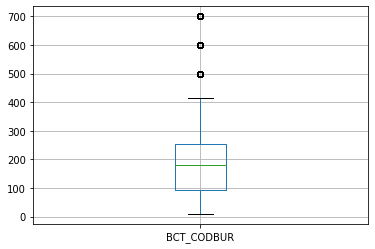

In [1213]:
df.boxplot(column = ['BCT_CODBUR'])

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


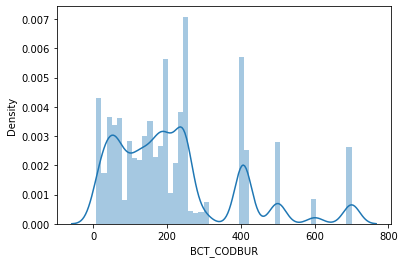

In [1214]:
sns.distplot(df['BCT_CODBUR'])

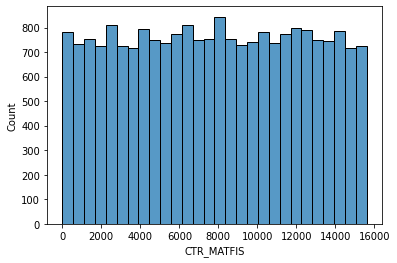

In [1215]:
sns.histplot(df['CTR_MATFIS'])

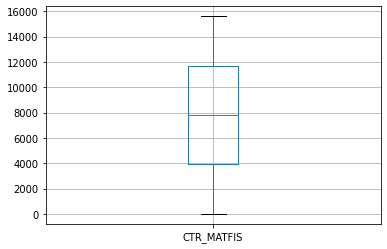

In [1216]:
df.boxplot(column= ['CTR_MATFIS'])

we will normalize our dataset to have uniform distribution 

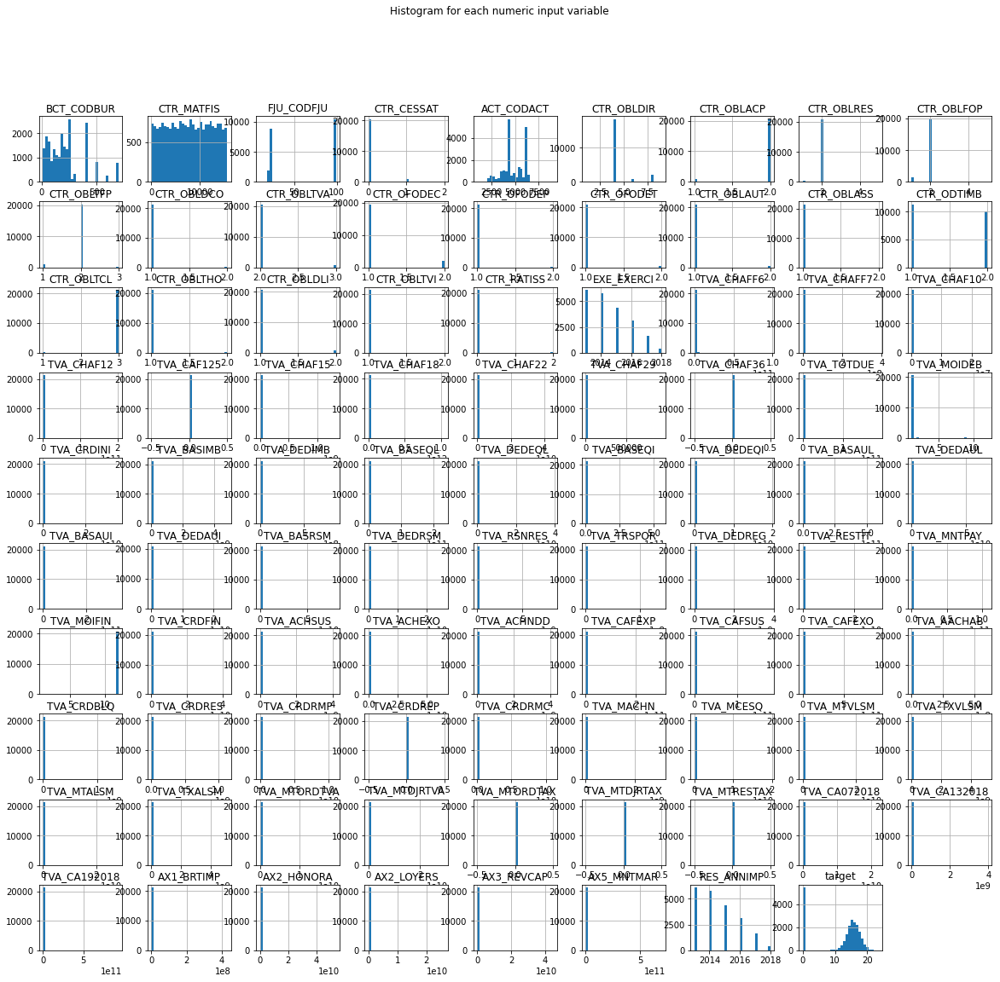

In [1217]:
df.drop(['id'] ,axis=1).hist(bins=30, figsize=(20,18))
plt.suptitle("Histogram for each numeric input variable")
plt.savefig('MTN_AFRICA_HIST')
plt.show()

In [1218]:
df["CTR_CATEGO_X"].value_counts()

M    10889
C     5794
P     4604
N        8
Name: CTR_CATEGO_X, dtype: int64

In [1219]:
#Dealing with categorical columns

df["CTR_CATEGO_X"] = df["CTR_CATEGO_X"].map({'M':1, 'C':2, 'P':3, 'N':4})


medianLLING

In [1220]:
from sklearn.linear_model import LinearRegression
from sklearn import metrics
from sklearn.model_selection import train_test_split
import xgboost as xgb
from sklearn.preprocessing import StandardScaler
from sklearn import preprocessing


In [1221]:
df.drop('TVA_MNTPAY', axis=1, inplace =True)

In [1222]:
x= df.drop(["target","id"], axis =1 )
y= df['target']

In [1223]:
#scaler = StandardScaler()
#scaled_data = scaler.fit_transform(df.drop('id', axis= 1))

normalized_data = preprocessing.normalize(x)

In [1224]:
normalized_data

array([[4.18131327e-08, 5.90135350e-06, 1.90059694e-09, ...,
        0.00000000e+00, 5.72810770e-01, 1.91390112e-06],
       [1.95513046e-06, 7.01262879e-05, 4.87563707e-09, ...,
        0.00000000e+00, 7.20872691e-02, 9.81465741e-06],
       [6.18094669e-06, 2.93912918e-04, 2.54359946e-08, ...,
        0.00000000e+00, 2.74525603e-01, 5.12026572e-05],
       ...,
       [6.56756184e-08, 2.27894396e-07, 9.38223120e-11, ...,
        0.00000000e+00, 6.00925072e-01, 1.88864314e-07],
       [5.90948669e-06, 3.15252052e-05, 2.38285754e-08, ...,
        0.00000000e+00, 7.90749939e-01, 4.79907508e-05],
       [7.73255900e-06, 3.75661776e-04, 4.21775946e-07, ...,
        1.56197692e-03, 0.00000000e+00, 2.83574027e-04]])

In [1225]:
df2 = pd.DataFrame(normalized_data)


In [1226]:
df2.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87
0,4.181313e-08,0.000006,1.900597e-09,9.407955e-08,0.0,0.000004,3.801194e-09,1.900597e-09,1.900597e-09,1.900597e-09,1.900597e-09,9.502985e-10,1.900597e-09,9.502985e-10,9.502985e-10,9.502985e-10,9.502985e-10,9.502985e-10,1.900597e-09,2.850895e-09,9.502985e-10,9.502985e-10,9.502985e-10,0.0,0.000002,0.000000,0.0,0.0,0.120140,0.0,0.0,0.717944,0.0,0.0,0.0,0.143647,9.502985e-10,0.000000,0.0,0.0,0.193388,0.03865,0.160076,0.022061,0.225841,0.038000,0.050129,0.007493,0.007574,0.003787,0.0,0.0,0.0,0.0,1.140358e-08,0.000000,0.0,0.0,0.0,0.035722,0.000580,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.002803,0.0,0.0,0.572811,0.000002
1,1.955130e-06,0.000070,4.875637e-09,1.072640e-07,0.0,0.000030,1.950255e-08,9.751274e-09,9.751274e-09,9.751274e-09,9.751274e-09,4.875637e-09,9.751274e-09,4.875637e-09,4.875637e-09,4.875637e-09,4.875637e-09,4.875637e-09,9.751274e-09,1.462691e-08,4.875637e-09,4.875637e-09,4.875637e-09,0.0,0.000010,0.000000,0.0,0.0,0.106856,0.0,0.0,0.000000,0.0,0.0,0.0,0.012823,4.875637e-09,0.000000,0.0,0.0,0.000000,0.00000,0.000000,0.000000,0.013517,0.002433,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,5.850764e-08,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.991480,0.0,0.0,0.072087,0.000010
2,6.180947e-06,0.000294,2.543599e-08,5.850279e-07,0.0,0.000146,1.017440e-07,5.087199e-08,5.087199e-08,5.087199e-08,5.087199e-08,2.543599e-08,5.087199e-08,5.087199e-08,2.543599e-08,2.543599e-08,2.543599e-08,2.543599e-08,5.087199e-08,7.630798e-08,2.543599e-08,2.543599e-08,2.543599e-08,0.0,0.000051,0.000000,0.0,0.0,0.000000,0.0,0.0,0.518220,0.0,0.0,0.0,0.093280,5.087199e-08,0.000000,0.0,0.0,0.000000,0.00000,0.000000,0.000000,0.497339,0.086765,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,3.052319e-07,0.000000,0.0,0.0,0.0,0.000000,0.596754,0.19077,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.274526,0.000051
3,1.533752e-07,0.000013,4.260423e-09,2.108909e-07,0.0,0.000009,8.520846e-09,4.260423e-09,4.260423e-09,4.260423e-09,4.260423e-09,2.130212e-09,4.260423e-09,2.130212e-09,2.130212e-09,4.260423e-09,4.260423e-09,2.130212e-09,2.130212e-09,6.390635e-09,2.130212e-09,4.260423e-09,2.130212e-09,0.0,0.000004,0.130756,0.0,0.0,0.000000,0.0,0.0,0.721037,0.0,0.0,0.0,0.137632,2.130212e-09,0.057462,0.0,0.0,0.000000,0.00000,0.000000,0.000000,0.652333,0.117420,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,2.556254e-08,0.037928,0.0,0.0,0.0,0.000000,0.000000,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000004
4,5.949344e-03,0.200720,1.416510e-04,3.257974e-03,0.0,0.892685,5.666042e-04,2.833021e-04,2.833021e-04,2.833021e-04,2.833021e-04,1.416510e-04,2.833021e-04,1.416510e-04,1.416510e-04,1.416510e-04,1.416510e-04,1.416510e-04,2.833021e-04,4.249531e-04,1.416510e-04,1.416510e-04,1.416510e-04,0.0,0.285285,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,1.416510e-04,0.000000,0.0,0.0,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,1.699813e-03,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.285285


In [1227]:
df2.columns = ['BCT_CODBUR', 'CTR_MATFIS', 'CTR_CATEGO_X', 'FJU_CODFJU', 'CTR_CESSAT',
       'ACT_CODACT', 'CTR_OBLDIR', 'CTR_OBLACP', 'CTR_OBLRES', 'CTR_OBLFOP',
       'CTR_OBLTFP', 'CTR_OBLDCO', 'CTR_OBLTVA', 'CTR_OFODEC', 'CTR_OFODEP',
       'CTR_OFODET', 'CTR_OBLAUT', 'CTR_OBLASS', 'CTR_ODTIMB', 'CTR_OBLTCL',
       'CTR_OBLTHO', 'CTR_OBLDLI', 'CTR_OBLTVI', 'CTR_RATISS', 'EXE_EXERCI',
       'TVA_CHAFF6', 'TVA_CHAFF7', 'TVA_CHAF10', 'TVA_CHAF12', 'TVA_CAF125',
       'TVA_CHAF15', 'TVA_CHAF18', 'TVA_CHAF22', 'TVA_CHAF29', 'TVA_CHAF36',
       'TVA_TOTDUE', 'TVA_MOIDEB', 'TVA_CRDINI', 'TVA_BASIMB', 'TVA_DEDIMB',
       'TVA_BASEQL', 'TVA_DEDEQL', 'TVA_BASEQI', 'TVA_DEDEQI', 'TVA_BASAUL',
       'TVA_DEDAUL', 'TVA_BASAUI', 'TVA_DEDAUI', 'TVA_BASRSM', 'TVA_DEDRSM',
       'TVA_RSNRES', 'TVA_TRSPOR', 'TVA_DEDREG', 'TVA_RESTIT',
       'TVA_MOIFIN', 'TVA_CRDFIN', 'TVA_ACHSUS', 'TVA_ACHEXO', 'TVA_ACHNDD',
       'TVA_CAFEXP', 'TVA_CAFSUS', 'TVA_CAFEXO', 'TVA_AACHAB', 'TVA_CRDBLQ',
       'TVA_CRDRES', 'TVA_CRDRMP', 'TVA_CRDREP', 'TVA_CRDRMC', 'TVA_MACHN',
       'TVA_MCESQ', 'TVA_MTVLSM', 'TVA_TXVLSM', 'TVA_MTALSM', 'TVA_TXALSM',
       'TVA_MTORDTVA', 'TVA_MTDJRTVA', 'TVA_MTORDTAX', 'TVA_MTDJRTAX',
       'TVA_MTRESTAX', 'TVA_CA072018', 'TVA_CA132018', 'TVA_CA192018',
       'AX1_BRTIMP', 'AX2_HONORA', 'AX2_LOYERS', 'AX3_REVCAP', 'AX5_MNTMAR',
       'RES_ANNIMP']

In [1228]:
df2.head()

,BCT_CODBUR,CTR_MATFIS,CTR_CATEGO_X,FJU_CODFJU,CTR_CESSAT,ACT_CODACT,CTR_OBLDIR,CTR_OBLACP,CTR_OBLRES,CTR_OBLFOP,CTR_OBLTFP,CTR_OBLDCO,CTR_OBLTVA,CTR_OFODEC,CTR_OFODEP,CTR_OFODET,CTR_OBLAUT,CTR_OBLASS,CTR_ODTIMB,CTR_OBLTCL,CTR_OBLTHO,CTR_OBLDLI,CTR_OBLTVI,CTR_RATISS,EXE_EXERCI,TVA_CHAFF6,TVA_CHAFF7,TVA_CHAF10,TVA_CHAF12,TVA_CAF125,TVA_CHAF15,TVA_CHAF18,TVA_CHAF22,TVA_CHAF29,TVA_CHAF36,TVA_TOTDUE,TVA_MOIDEB,TVA_CRDINI,TVA_BASIMB,TVA_DEDIMB,TVA_BASEQL,TVA_DEDEQL,TVA_BASEQI,TVA_DEDEQI,TVA_BASAUL,TVA_DEDAUL,TVA_BASAUI,TVA_DEDAUI,TVA_BASRSM,TVA_DEDRSM,TVA_RSNRES,TVA_TRSPOR,TVA_DEDREG,TVA_RESTIT,TVA_MOIFIN,TVA_CRDFIN,TVA_ACHSUS,TVA_ACHEXO,TVA_ACHNDD,TVA_CAFEXP,TVA_CAFSUS,TVA_CAFEXO,TVA_AACHAB,TVA_CRDBLQ,TVA_CRDRES,TVA_CRDRMP,TVA_CRDREP,TVA_CRDRMC,TVA_MACHN,TVA_MCESQ,TVA_MTVLSM,TVA_TXVLSM,TVA_MTALSM,TVA_TXALSM,TVA_MTORDTVA,TVA_MTDJRTVA,TVA_MTORDTAX,TVA_MTDJRTAX,TVA_MTRESTAX,TVA_CA072018,TVA_CA132018,TVA_CA192018,AX1_BRTIMP,AX2_HONORA,AX2_LOYERS,AX3_REVCAP,AX5_MNTMAR,RES_ANNIMP
0,4.181313e-08,0.000006,1.900597e-09,9.407955e-08,0.0,0.000004,3.801194e-09,1.900597e-09,1.900597e-09,1.900597e-09,1.900597e-09,9.502985e-10,1.900597e-09,9.502985e-10,9.502985e-10,9.502985e-10,9.502985e-10,9.502985e-10,1.900597e-09,2.850895e-09,9.502985e-10,9.502985e-10,9.502985e-10,0.0,0.000002,0.000000,0.0,0.0,0.120140,0.0,0.0,0.717944,0.0,0.0,0.0,0.143647,9.502985e-10,0.000000,0.0,0.0,0.193388,0.03865,0.160076,0.022061,0.225841,0.038000,0.050129,0.007493,0.007574,0.003787,0.0,0.0,0.0,0.0,1.140358e-08,0.000000,0.0,0.0,0.0,0.035722,0.000580,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.002803,0.0,0.0,0.572811,0.000002
1,1.955130e-06,0.000070,4.875637e-09,1.072640e-07,0.0,0.000030,1.950255e-08,9.751274e-09,9.751274e-09,9.751274e-09,9.751274e-09,4.875637e-09,9.751274e-09,4.875637e-09,4.875637e-09,4.875637e-09,4.875637e-09,4.875637e-09,9.751274e-09,1.462691e-08,4.875637e-09,4.875637e-09,4.875637e-09,0.0,0.000010,0.000000,0.0,0.0,0.106856,0.0,0.0,0.000000,0.0,0.0,0.0,0.012823,4.875637e-09,0.000000,0.0,0.0,0.000000,0.00000,0.000000,0.000000,0.013517,0.002433,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,5.850764e-08,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.991480,0.0,0.0,0.072087,0.000010
2,6.180947e-06,0.000294,2.543599e-08,5.850279e-07,0.0,0.000146,1.017440e-07,5.087199e-08,5.087199e-08,5.087199e-08,5.087199e-08,2.543599e-08,5.087199e-08,5.087199e-08,2.543599e-08,2.543599e-08,2.543599e-08,2.543599e-08,5.087199e-08,7.630798e-08,2.543599e-08,2.543599e-08,2.543599e-08,0.0,0.000051,0.000000,0.0,0.0,0.000000,0.0,0.0,0.518220,0.0,0.0,0.0,0.093280,5.087199e-08,0.000000,0.0,0.0,0.000000,0.00000,0.000000,0.000000,0.497339,0.086765,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,3.052319e-07,0.000000,0.0,0.0,0.0,0.000000,0.596754,0.19077,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.274526,0.000051
3,1.533752e-07,0.000013,4.260423e-09,2.108909e-07,0.0,0.000009,8.520846e-09,4.260423e-09,4.260423e-09,4.260423e-09,4.260423e-09,2.130212e-09,4.260423e-09,2.130212e-09,2.130212e-09,4.260423e-09,4.260423e-09,2.130212e-09,2.130212e-09,6.390635e-09,2.130212e-09,4.260423e-09,2.130212e-09,0.0,0.000004,0.130756,0.0,0.0,0.000000,0.0,0.0,0.721037,0.0,0.0,0.0,0.137632,2.130212e-09,0.057462,0.0,0.0,0.000000,0.00000,0.000000,0.000000,0.652333,0.117420,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,2.556254e-08,0.037928,0.0,0.0,0.0,0.000000,0.000000,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000004
4,5.949344e-03,0.200720,1.416510e-04,3.257974e-03,0.0,0.892685,5.666042e-04,2.833021e-04,2.833021e-04,2.833021e-04,2.833021e-04,1.416510e-04,2.833021e-04,1.416510e-04,1.416510e-04,1.416510e-04,1.416510e-04,1.416510e-04,2.833021e-04,4.249531e-04,1.416510e-04,1.416510e-04,1.416510e-04,0.0,0.285285,0.000000,0.0,0.0,0

In [1229]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size= 0.2, random_state= 5)

In [1230]:
lr = LinearRegression()
lr.fit(x_train, y_train)
lr_pred = lr.predict(x_test)
lr_rmse = np.sqrt(metrics.mean_squared_error(y_test, lr_pred))

In [1231]:
lr_rmse

7.022914742593622

In [1232]:
from sklearn.ensemble import RandomForestRegressor


In [1233]:
rf = RandomForestRegressor(n_estimators= 42)
rf.fit(x_train, y_train)
y_pred_rf = rf.predict(x_test)
rf_rmse = np.sqrt(metrics.mean_absolute_error(y_pred_rf, y_test))

In [1234]:
rf_rmse

2.0895332825166193

In [1235]:
df_dmatrix = xgb.DMatrix(data=x,label=y)

In [1236]:
xg_reg = xgb.XGBRegressor(objective ='reg:linear', colsample_bytree = 0.3, learning_rate = 0.1,
                max_depth = 5, alpha = 10, n_estimators = 10)

In [1237]:

xg_reg.fit(x_train,y_train)

preds = xg_reg.predict(x_test)

[16:19:18] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


In [1238]:
from sklearn.metrics import mean_squared_error

In [1239]:
rmse = np.sqrt(mean_squared_error(y_test, preds))
print("RMSE: %f" % (rmse))

RMSE: 7.497837


In [1240]:
params = {"objective":"reg:linear",'colsample_bytree': 0.3,'learning_rate': 0.1,
                'max_depth': 5, 'alpha': 10}

cv_results = xgb.cv(dtrain=df_dmatrix, params=params, nfold=3,
                    num_boost_round=100,early_stopping_rounds=10,metrics="rmse", as_pandas=True, seed=123)

[16:19:19] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[16:19:19] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[16:19:19] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


In [1241]:
cv_results.head()


,train-rmse-mean,train-rmse-std,test-rmse-mean,test-rmse-std
0,12.305018,0.025554,12.309635,0.059049
1,11.424508,0.004849,11.436467,0.073897
2,10.652002,0.016052,10.672662,0.060139
3,9.984550,0.030833,10.013789,0.047043
4,9.398510,0.025427,9.437023,0.036664


In [1242]:
print((cv_results["test-rmse-mean"]).tail(1))

99    6.102167
Name: test-rmse-mean, dtype: float64


Random forest is our best performing medianl with the least RMSE of 2

TEST DATA

In [1243]:
df1 = pd.read_csv("/content/SUPCOM_Test.csv")


In [1244]:
df1.head()

,BCT_CODBUR,CTR_MATFIS,CTR_CATEGO_X,FJU_CODFJU,CTR_CESSAT,ACT_CODACT,CTR_OBLDIR,CTR_OBLACP,CTR_OBLRES,CTR_OBLFOP,CTR_OBLTFP,CTR_OBLDCO,CTR_OBLTVA,CTR_OFODEC,CTR_OFODEP,CTR_OFODET,CTR_OBLAUT,CTR_OBLASS,CTR_ODTIMB,CTR_OBLTCL,CTR_OBLTHO,CTR_OBLDLI,CTR_OBLTVI,CTR_RATISS,EXE_EXERCI,TVA_CHAFF6,TVA_CHAFF7,TVA_CHAF10,TVA_CHAF12,TVA_CAF125,TVA_CHAF15,TVA_CHAF18,TVA_CHAF22,TVA_CHAF29,TVA_CHAF36,TVA_TOTDUE,TVA_MOIDEB,TVA_CRDINI,TVA_BASIMB,TVA_DEDIMB,TVA_BASEQL,TVA_DEDEQL,TVA_BASEQI,TVA_DEDEQI,TVA_BASAUL,TVA_DEDAUL,TVA_BASAUI,TVA_DEDAUI,TVA_BASRSM,TVA_DEDRSM,TVA_RSNRES,TVA_TRSPOR,TVA_DEDREG,TVA_RESTIT,TVA_MNTPAY,TVA_MOIFIN,TVA_CRDFIN,TVA_ACHSUS,TVA_ACHEXO,TVA_ACHNDD,TVA_CAFEXP,TVA_CAFSUS,TVA_CAFEXO,TVA_AACHAB,TVA_CRDBLQ,TVA_CRDRES,TVA_CRDRMP,TVA_CRDREP,TVA_CRDRMC,TVA_MACHN,TVA_MCESQ,TVA_MTVLSM,TVA_TXVLSM,TVA_MTALSM,TVA_TXALSM,TVA_MTORDTVA,TVA_MTDJRTVA,TVA_MTORDTAX,TVA_MTDJRTAX,TVA_MTRESTAX,TVA_CA072018,TVA_CA132018,TVA_CA192018,ADB_MNTORD,SND_MNTPRD_I,SND_MNTTVA_I,SND_MNTDRC_I,SND_MNTAVA_I,SND_MNTTAX_I,SND_MNTPAY_I,SND_MNTAIR_I,SND_MNTPRD_E,SND_MNTTVA_E,SND_MNTDRC_E,SND_MNTAVA_E,SND_MNTTAX_E,SND_MNTPAY_E,SND_MNTAIR_E,SND_MNTPRD_A,SND_MNTTVA_A,SND_MNTDRC_A,SND_MNTAVA_A,SND_MNTTAX_A,SND_MNTPAY_A,SND_MNTAIR_A,AX1_BRTIMP,AX2_HONORA,AX2_LOYERS,AX3_REVCAP,AX5_MNTMAR,RES_ANNIMP,FAC_MNTPRI_F,FAC_MFODEC_F,FAC_MNTDCO_F,FAC_MNTTVA_F,FAC_MNTPRI_C,FAC_MFODEC_C,FAC_MNTDCO_C,FAC_MNTTVA_C,id
0,238,5016,M,22,0,3601,4,2,2,2,2,1,2,1.0,1.0,1.0,1.0,1.0,2.0,3,1.0,1.0,1.0,0,2017,286953660.0,0.0,0.0,10394275.0,0.0,0.0,1.937050e+09,0.0,0.0,0.0,367133475.0,1.0,0.0,0.0,0.0,185278490.0,33350128.0,0.0,0.0,1.818614e+09,327350438.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6432909.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,43566520.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,34081114.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,369444404.0,2017,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,test_id1120
1,173,3757,M,22,0,3912,4,2,2,2,2,1,2,1.0,1.0,1.0,1.0,1.0,2.0,3,1.0,1.0,1.0,0,2017,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00,0.0,0.0,0.0,0.0,1.0,7200.0,0.0,0.0,0.0,0.0,0.0,0.0,1.000000e+05,18000.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12.0,18000.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,37387900.0,0.0,0.0,16470211.0,2017,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,test_id1680
2,125,15482,C,99,0,4221,4,2,2,1,1,1,2,1.0,1.0,1.0,1.0,1.0,1.0,3,1.0,1.0,1.0,0,2018,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,2018,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,test_id1063
3,9,11722,C,99,0,3203,4,2,2,2,2,1,2,1.0,1.0,1.0,1.0,1.0,1.0,3,1.0,1.0,1.0,0,2015,0.0,0.0,0.0,0.0,0.0,0.0,2.067658e+08,0.0,0.0,0.0,37217833.0,1.0,286137.0,0.0,0.0,17280450.0,3068481.0,0.0,0.0,1.903517e+08,34263815.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,266049.0,12.0,666649.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,750000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,3150000.0,34785.0,11529108.0,2015,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,test_id3731
4,153,6557,P,99,0,6308,4,2,2,2,2,1,2,1.0,1.0,1.0,1.0,1.0,1.0,3,1.0,1.0,1.0,0,2014,0.0,0.0,0.0,37190021.0,0.0,0.0,0.000000e+00,0.0,0.0,0.0,4574051.0,1.0,0.0,0.0,0.0,45000.0,8100.0,495498.0,74998.0,4.486672e+06,834466.0,620900.0,102270.0,0.0,0.0,0.0,0.0,0.0,0.0,3554217.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN

In [1245]:
df1.columns

Index(['BCT_CODBUR', 'CTR_MATFIS', 'CTR_CATEGO_X', 'FJU_CODFJU', 'CTR_CESSAT',
       'ACT_CODACT', 'CTR_OBLDIR', 'CTR_OBLACP', 'CTR_OBLRES', 'CTR_OBLFOP',
       ...
       'RES_ANNIMP', 'FAC_MNTPRI_F', 'FAC_MFODEC_F', 'FAC_MNTDCO_F',
       'FAC_MNTTVA_F', 'FAC_MNTPRI_C', 'FAC_MFODEC_C', 'FAC_MNTDCO_C',
       'FAC_MNTTVA_C', 'id'],
      dtype='object', length=120)

In [1246]:
df1.shape

(7517, 120)

In [1247]:
df1.isnull().sum()

BCT_CODBUR         0
CTR_MATFIS         0
CTR_CATEGO_X       0
FJU_CODFJU         0
CTR_CESSAT         0
ACT_CODACT         0
CTR_OBLDIR         0
CTR_OBLACP         0
CTR_OBLRES         0
CTR_OBLFOP         0
CTR_OBLTFP         0
CTR_OBLDCO         0
CTR_OBLTVA         0
CTR_OFODEC         1
CTR_OFODEP         1
CTR_OFODET         1
CTR_OBLAUT         1
CTR_OBLASS         1
CTR_ODTIMB         1
CTR_OBLTCL         0
CTR_OBLTHO         1
CTR_OBLDLI         1
CTR_OBLTVI         1
CTR_RATISS         0
EXE_EXERCI         0
TVA_CHAFF6       555
TVA_CHAFF7       555
TVA_CHAF10       555
TVA_CHAF12       555
TVA_CAF125       555
TVA_CHAF15       555
TVA_CHAF18       555
TVA_CHAF22       555
TVA_CHAF29       555
TVA_CHAF36       555
TVA_TOTDUE       555
TVA_MOIDEB       555
TVA_CRDINI       555
TVA_BASIMB       555
TVA_DEDIMB       555
TVA_BASEQL       555
TVA_DEDEQL       555
TVA_BASEQI       555
TVA_DEDEQI       555
TVA_BASAUL       555
TVA_DEDAUL       555
TVA_BASAUI       555
TVA_DEDAUI   

DATA CLEANING

In [1248]:
df1.duplicated().sum()

0

In [1249]:
df1["CTR_OFODEC"].fillna(df1["CTR_OFODEC"].median(), inplace =True)
df1["CTR_OFODEP"].fillna(df1["CTR_OFODEP"].median(), inplace =True)
df1["CTR_OFODET"].fillna(df1["CTR_OFODET"].median(), inplace =True)
df1["CTR_OBLAUT"].fillna(df1["CTR_OBLAUT"].median(), inplace =True)
df1["CTR_OBLASS"].fillna(df1["CTR_OBLASS"].median(), inplace =True)
df1["CTR_ODTIMB"].fillna(df1["CTR_ODTIMB"].median(), inplace =True)
df1["CTR_OBLTHO"].fillna(df1["CTR_OBLTHO"].median(), inplace =True)
df1["CTR_OBLDLI"].fillna(df1["CTR_OBLDLI"].median(), inplace =True)
df1["CTR_OBLTVI"].fillna(df1["CTR_OBLTVI"].median(), inplace =True)
df1["TVA_CHAFF6"].fillna(df1["TVA_CHAFF6"].median(), inplace =True)
df1["TVA_CHAFF7"].fillna(df1["TVA_CHAFF7"].median(), inplace =True)
df1["TVA_CHAF10"].fillna(df1["TVA_CHAF10"].median(), inplace =True)
df1["TVA_CHAF12"].fillna(df1["TVA_CHAF12"].median(), inplace =True)
df1["TVA_CAF125"].fillna(df1["TVA_CAF125"].median(), inplace =True)
df1["TVA_CHAF15"].fillna(df1["TVA_CHAF15"].median(), inplace =True)
df1["TVA_CHAF18"].fillna(df1["TVA_CHAF18"].median(), inplace =True)
df1["TVA_CHAF22"].fillna(df1["TVA_CHAF22"].median(), inplace =True)
df1["TVA_CHAF29"].fillna(df1["TVA_CHAF29"].median(), inplace =True)
df1["TVA_CHAF36"].fillna(df1["TVA_CHAF36"].median(), inplace =True)
df1["TVA_TOTDUE"].fillna(df1["TVA_TOTDUE"].median(), inplace =True)
df1["TVA_MOIDEB"].fillna(df1["TVA_MOIDEB"].median(), inplace =True)
df1["TVA_CRDINI"].fillna(df1["TVA_CRDINI"].median(), inplace =True)
df1['TVA_BASIMB'].fillna(df1['TVA_BASIMB'].median(), inplace =True)
df1['TVA_DEDIMB'].fillna(df1['TVA_DEDIMB'].median(), inplace =True)
df1['TVA_BASEQL'].fillna(df1['TVA_BASEQL'].median(), inplace =True)
df1['TVA_DEDEQL'].fillna(df1['TVA_DEDEQL'].median(), inplace =True)
df1['TVA_BASEQI'].fillna(df1['TVA_BASEQI'].median(), inplace =True)
df1['TVA_DEDEQI'].fillna(df1['TVA_DEDEQI'].median(), inplace =True)
df1['TVA_BASAUL'].fillna(df1['TVA_BASAUL'].median(), inplace =True)
df1['TVA_DEDAUL'].fillna(df1['TVA_DEDAUL'].median(), inplace =True)
df1['TVA_BASAUI'].fillna(df1['TVA_BASAUI'].median(),inplace=True)
df1["TVA_DEDAUI"].fillna(df1["TVA_DEDAUI"].median(), inplace =True)
df1['TVA_BASRSM'].fillna(df1['TVA_BASRSM'].median(), inplace =True)
df1['TVA_DEDRSM'].fillna(df1['TVA_DEDRSM'].median(), inplace =True)
df1['TVA_RSNRES'].fillna(df1['TVA_RSNRES'].median(), inplace =True)
df1['TVA_TRSPOR'].fillna(df1['TVA_TRSPOR'].median(), inplace =True)
df1['TVA_DEDREG'].fillna(df1['TVA_DEDREG'].median(), inplace =True)
df1['TVA_RESTIT'].fillna(df1['TVA_RESTIT'].median(), inplace =True)

df1['TVA_MOIFIN'].fillna(df1['TVA_MOIFIN'].median(), inplace =True)
df1['TVA_CRDFIN'].fillna(df1['TVA_CRDFIN'].median(),inplace=True)
df1['TVA_ACHSUS'].fillna(df1['TVA_ACHSUS'].median(), inplace =True)
df1['TVA_ACHEXO'].fillna(df1['TVA_ACHEXO'].median(), inplace =True)
df1['TVA_ACHNDD'].fillna(df1['TVA_ACHNDD'].median(), inplace =True)
df1['TVA_CAFEXP'].fillna(df1['TVA_CAFEXP'].median(), inplace =True)
df1['TVA_CAFSUS'].fillna(df1['TVA_CAFSUS'].median(), inplace =True)
df1['TVA_CAFEXO'].fillna(df1['TVA_CAFEXO'].median(), inplace =True)
df1['TVA_AACHAB'].fillna(df1['TVA_AACHAB'].median(), inplace =True)
df1['TVA_CRDBLQ'].fillna(df1['TVA_CRDBLQ'].median(), inplace =True)
df1['TVA_CRDRES'].fillna(df1['TVA_CRDRES'].median(),inplace=True)
df1['TVA_CRDRMP'].fillna(df1['TVA_CRDRMP'].median(), inplace =True)
df1['TVA_CRDREP'].fillna(df1['TVA_CRDREP'].median(), inplace =True)
df1['TVA_CRDRMC'].fillna(df1['TVA_CRDRMC'].median(), inplace =True)
df1['TVA_MACHN'].fillna(df1['TVA_MACHN'].median(), inplace =True)
df1['TVA_MCESQ'].fillna(df1['TVA_MCESQ'].median(), inplace =True)
df1['TVA_MTVLSM'].fillna(df1['TVA_MTVLSM'].median(), inplace =True)
df1['TVA_TXVLSM'].fillna(df1['TVA_TXVLSM'].median(), inplace =True)
df1['TVA_MTALSM'].fillna(df1['TVA_MTALSM'].median(), inplace =True)
df1['TVA_TXALSM'].fillna(df1['TVA_TXALSM'].median(),inplace=True)
df1['TVA_MTORDTVA'].fillna(df1['TVA_MTORDTVA'].median(), inplace =True)
df1['TVA_MTDJRTVA'].fillna(df1['TVA_MTDJRTVA'].median(), inplace =True)
df1['TVA_MTORDTAX'].fillna(df1['TVA_MTORDTAX'].median(), inplace =True)
df1['TVA_MTDJRTAX'].fillna(df1['TVA_MTDJRTAX'].median(), inplace =True)
df1['TVA_MTRESTAX'].fillna(df1['TVA_MTRESTAX'].median(), inplace =True)
df1['TVA_CA072018'].fillna(df1['TVA_CA072018'].median(), inplace =True)
df1['TVA_CA132018'].fillna(df1['TVA_CA132018'].median(), inplace =True)
df1['TVA_CRDBLQ'].fillna(df1['TVA_CRDBLQ'].median(), inplace =True)
df1['TVA_CA192018'].fillna(df1['TVA_CA192018'].median(),inplace=True)

df1['AX1_BRTIMP'].fillna(df1['AX1_BRTIMP'].median(), inplace =True)
df1['AX2_HONORA'].fillna(df1['AX2_HONORA'].median(), inplace =True)
df1['AX2_LOYERS'].fillna(df1['AX2_LOYERS'].median(), inplace =True)
df1['AX3_REVCAP'].fillna(df1['AX3_REVCAP'].median(), inplace =True)
df1['AX5_MNTMAR'].fillna(df1['AX5_MNTMAR'].median(), inplace =True)





In [1250]:
df1.dropna(inplace = True, axis = 1)

In [1251]:
df1.isnull().sum()

BCT_CODBUR      0
CTR_MATFIS      0
CTR_CATEGO_X    0
FJU_CODFJU      0
CTR_CESSAT      0
ACT_CODACT      0
CTR_OBLDIR      0
CTR_OBLACP      0
CTR_OBLRES      0
CTR_OBLFOP      0
CTR_OBLTFP      0
CTR_OBLDCO      0
CTR_OBLTVA      0
CTR_OFODEC      0
CTR_OFODEP      0
CTR_OFODET      0
CTR_OBLAUT      0
CTR_OBLASS      0
CTR_ODTIMB      0
CTR_OBLTCL      0
CTR_OBLTHO      0
CTR_OBLDLI      0
CTR_OBLTVI      0
CTR_RATISS      0
EXE_EXERCI      0
TVA_CHAFF6      0
TVA_CHAFF7      0
TVA_CHAF10      0
TVA_CHAF12      0
TVA_CAF125      0
TVA_CHAF15      0
TVA_CHAF18      0
TVA_CHAF22      0
TVA_CHAF29      0
TVA_CHAF36      0
TVA_TOTDUE      0
TVA_MOIDEB      0
TVA_CRDINI      0
TVA_BASIMB      0
TVA_DEDIMB      0
TVA_BASEQL      0
TVA_DEDEQL      0
TVA_BASEQI      0
TVA_DEDEQI      0
TVA_BASAUL      0
TVA_DEDAUL      0
TVA_BASAUI      0
TVA_DEDAUI      0
TVA_BASRSM      0
TVA_DEDRSM      0
TVA_RSNRES      0
TVA_TRSPOR      0
TVA_DEDREG      0
TVA_RESTIT      0
TVA_MOIFIN      0
TVA_CRDFIN

In [1252]:
df2.columns

Index(['BCT_CODBUR', 'CTR_MATFIS', 'CTR_CATEGO_X', 'FJU_CODFJU', 'CTR_CESSAT',
       'ACT_CODACT', 'CTR_OBLDIR', 'CTR_OBLACP', 'CTR_OBLRES', 'CTR_OBLFOP',
       'CTR_OBLTFP', 'CTR_OBLDCO', 'CTR_OBLTVA', 'CTR_OFODEC', 'CTR_OFODEP',
       'CTR_OFODET', 'CTR_OBLAUT', 'CTR_OBLASS', 'CTR_ODTIMB', 'CTR_OBLTCL',
       'CTR_OBLTHO', 'CTR_OBLDLI', 'CTR_OBLTVI', 'CTR_RATISS', 'EXE_EXERCI',
       'TVA_CHAFF6', 'TVA_CHAFF7', 'TVA_CHAF10', 'TVA_CHAF12', 'TVA_CAF125',
       'TVA_CHAF15', 'TVA_CHAF18', 'TVA_CHAF22', 'TVA_CHAF29', 'TVA_CHAF36',
       'TVA_TOTDUE', 'TVA_MOIDEB', 'TVA_CRDINI', 'TVA_BASIMB', 'TVA_DEDIMB',
       'TVA_BASEQL', 'TVA_DEDEQL', 'TVA_BASEQI', 'TVA_DEDEQI', 'TVA_BASAUL',
       'TVA_DEDAUL', 'TVA_BASAUI', 'TVA_DEDAUI', 'TVA_BASRSM', 'TVA_DEDRSM',
       'TVA_RSNRES', 'TVA_TRSPOR', 'TVA_DEDREG', 'TVA_RESTIT', 'TVA_MOIFIN',
       'TVA_CRDFIN', 'TVA_ACHSUS', 'TVA_ACHEXO', 'TVA_ACHNDD', 'TVA_CAFEXP',
       'TVA_CAFSUS', 'TVA_CAFEXO', 'TVA_AACHAB', 'TVA_CRDBLQ', 'TVA_CRDRES

In [1253]:
df1.columns

Index(['BCT_CODBUR', 'CTR_MATFIS', 'CTR_CATEGO_X', 'FJU_CODFJU', 'CTR_CESSAT',
       'ACT_CODACT', 'CTR_OBLDIR', 'CTR_OBLACP', 'CTR_OBLRES', 'CTR_OBLFOP',
       'CTR_OBLTFP', 'CTR_OBLDCO', 'CTR_OBLTVA', 'CTR_OFODEC', 'CTR_OFODEP',
       'CTR_OFODET', 'CTR_OBLAUT', 'CTR_OBLASS', 'CTR_ODTIMB', 'CTR_OBLTCL',
       'CTR_OBLTHO', 'CTR_OBLDLI', 'CTR_OBLTVI', 'CTR_RATISS', 'EXE_EXERCI',
       'TVA_CHAFF6', 'TVA_CHAFF7', 'TVA_CHAF10', 'TVA_CHAF12', 'TVA_CAF125',
       'TVA_CHAF15', 'TVA_CHAF18', 'TVA_CHAF22', 'TVA_CHAF29', 'TVA_CHAF36',
       'TVA_TOTDUE', 'TVA_MOIDEB', 'TVA_CRDINI', 'TVA_BASIMB', 'TVA_DEDIMB',
       'TVA_BASEQL', 'TVA_DEDEQL', 'TVA_BASEQI', 'TVA_DEDEQI', 'TVA_BASAUL',
       'TVA_DEDAUL', 'TVA_BASAUI', 'TVA_DEDAUI', 'TVA_BASRSM', 'TVA_DEDRSM',
       'TVA_RSNRES', 'TVA_TRSPOR', 'TVA_DEDREG', 'TVA_RESTIT', 'TVA_MOIFIN',
       'TVA_CRDFIN', 'TVA_ACHSUS', 'TVA_ACHEXO', 'TVA_ACHNDD', 'TVA_CAFEXP',
       'TVA_CAFSUS', 'TVA_CAFEXO', 'TVA_AACHAB', 'TVA_CRDBLQ', 'TVA_CRDRES

In [1254]:
df1["CTR_CATEGO_X"] = df1["CTR_CATEGO_X"].map({'M':1, 'C':2, 'P':3, 'N':4})



In [1255]:
df1.shape

(7517, 89)

In [1256]:
#scaler = StandardScaler()
#scaled_data1 = scaler.fit_transform(df1.drop("id",axis=1 ))

In [1257]:
#df4 = pd.DataFrame(scaled_data1)


In [1258]:
"""df4.columns=['BCT_CODBUR', 'CTR_MATFIS', 'CTR_CATEGO_X', 'FJU_CODFJU', 'CTR_CESSAT',
       'ACT_CODACT', 'CTR_OBLDIR', 'CTR_OBLACP', 'CTR_OBLRES', 'CTR_OBLFOP',
       'CTR_OBLTFP', 'CTR_OBLDCO', 'CTR_OBLTVA', 'CTR_OBLTCL', 'CTR_RATISS',
       'EXE_EXERCI', 'ADB_MNTORD', 'SND_MNTPRD_I', 'SND_MNTTVA_I',
       'SND_MNTDRC_I', 'SND_MNTAVA_I', 'SND_MNTTAX_I', 'SND_MNTPAY_I',
       'SND_MNTAIR_I', 'SND_MNTPRD_E', 'SND_MNTTVA_E', 'SND_MNTDRC_E',
       'SND_MNTAVA_E', 'SND_MNTTAX_E', 'SND_MNTPAY_E', 'SND_MNTAIR_E',
       'SND_MNTPRD_A', 'SND_MNTTVA_A', 'SND_MNTDRC_A', 'SND_MNTAVA_A',
       'SND_MNTTAX_A', 'SND_MNTPAY_A', 'SND_MNTAIR_A', 'RES_ANNIMP',
       'FAC_MNTPRI_F', 'FAC_MFODEC_F', 'FAC_MNTDCO_F', 'FAC_MNTTVA_F',
       'FAC_MNTPRI_C', 'FAC_MFODEC_C', 'FAC_MNTDCO_C', 'FAC_MNTTVA_C']"""

"df4.columns=['BCT_CODBUR', 'CTR_MATFIS', 'CTR_CATEGO_X', 'FJU_CODFJU', 'CTR_CESSAT',\n       'ACT_CODACT', 'CTR_OBLDIR', 'CTR_OBLACP', 'CTR_OBLRES', 'CTR_OBLFOP',\n       'CTR_OBLTFP', 'CTR_OBLDCO', 'CTR_OBLTVA', 'CTR_OBLTCL', 'CTR_RATISS',\n       'EXE_EXERCI', 'ADB_MNTORD', 'SND_MNTPRD_I', 'SND_MNTTVA_I',\n       'SND_MNTDRC_I', 'SND_MNTAVA_I', 'SND_MNTTAX_I', 'SND_MNTPAY_I',\n       'SND_MNTAIR_I', 'SND_MNTPRD_E', 'SND_MNTTVA_E', 'SND_MNTDRC_E',\n       'SND_MNTAVA_E', 'SND_MNTTAX_E', 'SND_MNTPAY_E', 'SND_MNTAIR_E',\n       'SND_MNTPRD_A', 'SND_MNTTVA_A', 'SND_MNTDRC_A', 'SND_MNTAVA_A',\n       'SND_MNTTAX_A', 'SND_MNTPAY_A', 'SND_MNTAIR_A', 'RES_ANNIMP',\n       'FAC_MNTPRI_F', 'FAC_MFODEC_F', 'FAC_MNTDCO_F', 'FAC_MNTTVA_F',\n       'FAC_MNTPRI_C', 'FAC_MFODEC_C', 'FAC_MNTDCO_C', 'FAC_MNTTVA_C']"

In [1259]:
rf = RandomForestRegressor(n_estimators= 42)

rf.fit(x_train,y_train)

pred_rfn = rf.predict(df1.drop("id",axis=1))

In [1260]:
pred_rfn

array([15.03503712, 14.49986273,  7.50304997, ..., 16.63451105,
        9.32083548, 12.09218121])

In [1261]:
"""xg_reg2 = xgb.XGBRegressor(objective ='reg:linear', colsample_bytree = 0.3, learning_rate = 0.1,
                max_depth = 5, alpha = 10, n_estimators = 50)"""

"xg_reg2 = xgb.XGBRegressor(objective ='reg:linear', colsample_bytree = 0.3, learning_rate = 0.1,\n                max_depth = 5, alpha = 10, n_estimators = 50)"

In [1262]:
"""xg_reg2.fit(x_train,y_train)

preds_1 = xg_reg2.predict(df4)"""

'xg_reg2.fit(x_train,y_train)\n\npreds_1 = xg_reg2.predict(df4)'

In [1263]:
pred_rfn

array([15.03503712, 14.49986273,  7.50304997, ..., 16.63451105,
        9.32083548, 12.09218121])

In [1264]:
#df4['target'] = preds_1

In [1265]:
df1['target'] = pred_rfn

In [1267]:
submission = df1[['id', 'target']].to_csv('submission_finaly1.csv', index=False)

#working on challenging the solution